<div style="border:2px solid #422e13; border-radius:30px;  background:#ffffff;">
    <div style="padding:10px 10px 10px 0px; margin:5px; border-radius:23px; background:#1FAEE9; text-align:center;">
        <span style="font-family:sans-serif; font-size:38px; color:#fff;">Цены на недвижимость в Мельбурне</span>
    </div>
</div>

 <a id='top'></a>
<div class="list-group" id="list-tab" role="tablist">
<p style="background-color:#1FAEE9;font-family:sans-serif;color:#FFF9ED;font-size:200%;text-align:center;border-radius:15px 15px;">СОДЕРЖАНИЕ</p>   
    
* [1. ЗАДАЧА](#1)
    
* [2. ИМПОРТ НЕОБХОДИМЫХ БИБЛИОТЕК](#2)
    
* [3. ЗАГРУЗКА ДАТАСЕТА](#3)
    
* [4. ПОЛУЧЕНИЕ ИНОФРМАЦИИ О ДАТЕСЕТЕ](#4)
    * [4.1. Подготовка таблицы](#4.1)       
    * [4.2. Основаная информация о датасете](#4.2)    
    * [4.3. Пропущенные значения](#4.3)    
    * [4.4. Дубликаты ](#4.4)
    * [4.5. Числовые перменные ](#4.5)
    * [4.6. Колличественные перменные ](#4.6) 
        
    
* [5. РАЗВЕДОВАТЕЛЬНЫЙ АНАЛИЗ ДАННЫХ](#5)
       
* [6. ПРЕДВАРИТЕЛЬНАЯ ОБРАБОТКА НАБОРА ДАННЫХ](#6)
        
* [7. МОДЕЛИРОВАНИЕ](#7)
    * [7.1. Создание дпоплнительных фичей ](#7.1) 
    * [7.2. Catboost ](#7.2) 
    * [7.3. Keras](#7.3)    
        
    
* [8. ВЫВОДЫ](#8)

<a id="1"></a>

## <b>1 <span style='color:#422e13;font-family:cursive;'>|</span> ЗАДАЧА </b>

<div style="border:2px solid blue; border-radius:1px; padding:1px">
    <img src="https://wikiway.com/upload/home/t/tema389/smileplanet.ru/public_html/upload/hl-photo/33f/melbourne_49.jpg/f1a/melbourne_49.jpg" width="100%">
</div>
<div style="padding:4px">

<div style="border-radius:10px;
            border : black solid; font-family:sans-serif;
            background-color:#1FAEE9;
            font-size:120%;
            text-align: left">

<h3 style='; border:15; border-radius: 15px; font-weight: bold; color:white'><center>Цена на жилье</center></h3>  
    
<span style="color:#ffffff">Даны данные о ценах на недвижимость в Мельбурне.</span>    
<span style="color:#ffffff">Каждая строчка – это объект недвижимости, по которому известны некоторые параметры и его цена.</span>    

#### <span style="color:#ffffff">Задача по параметрам определить цену объекта</span> 

<a id="2"></a>

## <b>2 <span style='color:#422e13; font-family:cursive;'>|</span> ИМПОРТ НЕОБХОДИМЫХ БИБЛИОТЕК</b>

In [1]:
#!pip install catboost
!pip install phik -q

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import folium

import joblib

from folium.plugins import MarkerCluster

from collections import Counter
import phik

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from sklearn import preprocessing
from sklearn.impute import SimpleImputer



from catboost import Pool
from catboost import CatBoostRegressor
from catboost import cv

import optuna
optuna.logging.set_verbosity(optuna.logging.WARNING)

import warnings
warnings.filterwarnings("ignore")



<a id="3"></a>

## <b>3 <span style='color:#422e13;font-family: cursive;'>|</span> ЗАГРУЗКА ДАТАСЕТА</b>

In [3]:
df = pd.read_csv('/kaggle/input/leopard-challenge-regression/train.csv') 
df_test = pd.read_csv('/kaggle/input/leopard-challenge-regression/test.csv')

In [4]:
df.head(n = 7).style.set_properties(**{"background-color": "#FAE7B5", "font-size" : "15px",
                                        "color": "#003153", "border": "1.5px solid black"})

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,id
0,Abbotsford,85 Turner St,2,h,1480000.000000,S,Biggin,3/12/2016,2.500000,3067.000000,2.000000,1.000000,1.000000,202.000000,nan,nan,Yarra City Council,-37.799600,144.998400,Northern Metropolitan,4019.000000,34302
1,Abbotsford,25 Bloomburg St,2,h,1035000.000000,S,Biggin,4/02/2016,2.500000,3067.000000,2.000000,1.000000,0.000000,156.000000,79.000000,1900.000000,Yarra City Council,-37.807900,144.993400,Northern Metropolitan,4019.000000,33247
2,Abbotsford,5 Charles St,3,h,1465000.000000,SP,Biggin,4/03/2017,2.500000,3067.000000,3.000000,2.000000,0.000000,134.000000,150.000000,1900.000000,Yarra City Council,-37.809300,144.994400,Northern Metropolitan,4019.000000,31886
3,Abbotsford,40 Federation La,3,h,850000.000000,PI,Biggin,4/03/2017,2.500000,3067.000000,3.000000,2.000000,1.000000,94.000000,nan,nan,Yarra City Council,-37.796900,144.996900,Northern Metropolitan,4019.000000,18999
4,Abbotsford,55a Park St,4,h,1600000.000000,VB,Nelson,4/06/2016,2.500000,3067.000000,3.000000,1.000000,2.000000,120.000000,142.000000,2014.000000,Yarra City Council,-37.807200,144.994100,Northern Metropolitan,4019.000000,16809
5,Abbotsford,129 Charles St,2,h,941000.000000,S,Jellis,7/05/2016,2.500000,3067.000000,2.000000,1.000000,0.000000,181.000000,nan,nan,Yarra City Council,-37.804100,144.995300,Northern Metropolitan,4019.000000,33671
6,Abbotsford,124 Yarra St,3,h,1876000.000000,S,Nelson,7/05/2016,2.500000,3067.000000,4.000000,2.000000,0.000000,245.000000,210.000000,1910.000000,Yarra City Council,-37.802400,144.999300,Northern Metropolitan,4019.000000,18292


<a id="4"></a>

## <b>4 <span style='color:#422e13'>|</span> ПОЛУЧЕНИЕ ИНОФРМАЦИИ О ДАТЕСЕТЕ </b>

<a id="4.1"></a>

#### <b>4.1 <span style='color:#422e13'>|</span> Подготовка таблицы</b>

In [5]:
df.columns = df.columns.str.lower()
df_test.columns = df_test.columns.str.lower()

In [6]:
df['date'] = pd.to_datetime(df['date'], format="%d/%m/%Y")
df_test['date'] = pd.to_datetime(df_test['date'], format="%d/%m/%Y")

<a id="4.2"></a>

#### <b>4.2 <span style='color:#422e13'>|</span> Основаная информация о датасете</b>

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18373 entries, 0 to 18372
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   suburb         18373 non-null  object        
 1   address        18373 non-null  object        
 2   rooms          18373 non-null  int64         
 3   type           18373 non-null  object        
 4   price          18373 non-null  float64       
 5   method         18373 non-null  object        
 6   sellerg        18373 non-null  object        
 7   date           18373 non-null  datetime64[ns]
 8   distance       18373 non-null  float64       
 9   postcode       18373 non-null  float64       
 10  bedroom2       14905 non-null  float64       
 11  bathroom       14903 non-null  float64       
 12  car            14798 non-null  float64       
 13  landsize       13579 non-null  float64       
 14  buildingarea   7750 non-null   float64       
 15  yearbuilt      8944

Таблица состоит из 18373 строк и 22 столбцов. 

In [8]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8818 entries, 0 to 8817
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   suburb         8818 non-null   object        
 1   address        8818 non-null   object        
 2   rooms          8818 non-null   int64         
 3   type           8818 non-null   object        
 4   method         8818 non-null   object        
 5   sellerg        8818 non-null   object        
 6   date           8818 non-null   datetime64[ns]
 7   distance       8817 non-null   float64       
 8   postcode       8817 non-null   float64       
 9   bedroom2       5858 non-null   float64       
 10  bathroom       5854 non-null   float64       
 11  car            5582 non-null   float64       
 12  landsize       4365 non-null   float64       
 13  buildingarea   2882 non-null   float64       
 14  yearbuilt      3112 non-null   float64       
 15  councilarea    8816 n

Таблица состоит из 8818 строк и 22 столбцов. 

<a id="4.3"></a>

#### <b>4.3 <span style='color:#422e13'>|</span> Пропущенные значения</b>

In [9]:
df.isna().sum()

suburb               0
address              0
rooms                0
type                 0
price                0
method               0
sellerg              0
date                 0
distance             0
postcode             0
bedroom2          3468
bathroom          3470
car               3575
landsize          4794
buildingarea     10623
yearbuilt         9429
councilarea          1
lattitude         3332
longtitude        3332
regionname           1
propertycount        1
id                   0
dtype: int64

In [10]:
df_test.isna().sum()

suburb              0
address             0
rooms               0
type                0
method              0
sellerg             0
date                0
distance            1
postcode            1
bedroom2         2960
bathroom         2964
car              3236
landsize         4453
buildingarea     5936
yearbuilt        5706
councilarea         2
lattitude        2910
longtitude       2910
regionname          2
propertycount       2
id                  0
dtype: int64

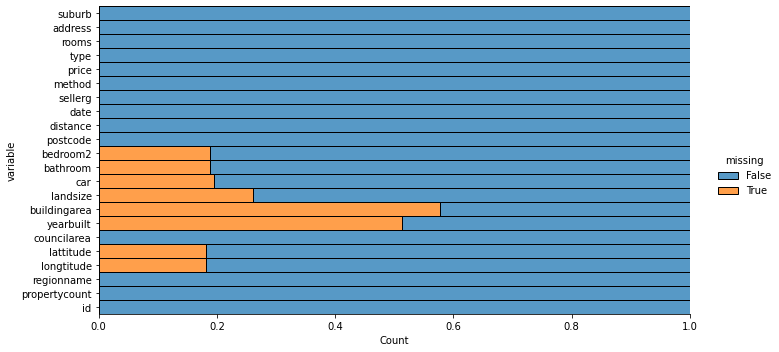

In [11]:
sns.displot(
    data = df.isna().melt(value_name = "missing"),
    y = "variable",
    hue = "missing",
    multiple = "fill",
    aspect = 2)
plt.show()


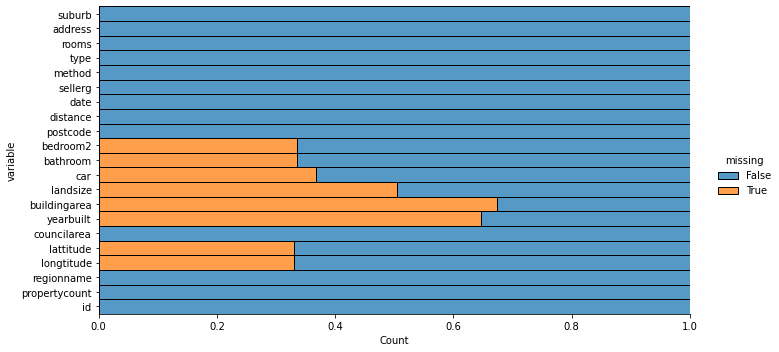

In [12]:
sns.displot(
    data = df_test.isna().melt(value_name = "missing"),
    y = "variable",
    hue = "missing",
    multiple = "fill",
    aspect = 2)
plt.show()


Мы имеем пропущенные значения в столбцах bedroom2, bathroom, car, landsize, buildingarea, yearbuilt, councilarea, lattitude, longtitude, regionname, propertycount.

<a id="4.4"></a>

#### <b>4.4 <span style='color:#422e13'>|</span>Дубликаты</b>

In [13]:
df.duplicated().sum()

0

In [14]:
df_test.duplicated().sum()

0

<a id="4.5"></a>

#### <b>4.5 <span style='color:#422e13'>|</span> Числовые перменные</b>

In [15]:
df.describe().T.style.background_gradient(cmap = "summer")

,count,mean,std,min,25%,50%,75%,max
rooms,18373.000000,2.936592,0.955952,1.000000,2.000000,3.000000,3.000000,12.000000
price,18373.000000,1053234.882218,621797.251963,227000.000000,635000.000000,880000.000000,1301000.000000,5580000.000000
distance,18373.000000,10.403962,6.018424,0.000000,6.300000,9.700000,13.300000,48.100000
postcode,18373.000000,3107.258314,95.285542,3000.000000,3046.000000,3085.000000,3149.000000,3978.000000
bedroom2,14905.000000,2.914928,0.962743,0.000000,2.000000,3.000000,3.000000,20.000000
bathroom,14903.000000,1.538683,0.688374,0.000000,1.000000,1.000000,2.000000,8.000000
car,14798.000000,1.617313,0.957072,0.000000,1.000000,2.000000,2.000000,10.000000
landsize,13579.000000,558.937403,3991.516323,0.000000,177.000000,440.000000,651.000000,433014.000000
buildingarea,7750.000000,151.133167,519.517626,0.000000,93.000000,126.000000,173.862500,44515.000000
yearbuilt,8944.000000,1965.925089,36.958956,1196.000000,1950.000000,1970.000000,2000.000000,2018.000000


<div style="border-radius: 10px;
            border : black solid;
            background-color: #1FAEE9;
            font-size:110%;
            text-align: left">

<h3 style='; border:0; border-radius: 10px; font-weight: bold; color:black'><center> Описание числовых переменных</center></h3>
    
    
    
● Минимальное колличество комнат - 1, максимальное колличество комнат - 12.

● Квартиры расположены в радусе 48 километров от центра (максимальное расстояние - 48,1). В среднем квартиры расположены в 10 км от центра.     

● Минимальная цена продажи - 227 000 евро, максимальная цена продажи - 5 580 000 евро, средняя цена продажи - 1 053 234 евро.    
    
● Квартиры продаются без спален (может быть это студия? посмотрим дальше), максимально 20 спален.

● Квартиры продаются без ванной комнаты (может быть это студия? посмотрим дальше), максимально 20 ванных комнат.
    
● Кваритры либо не имеет парковочного места, максимально 10 парковочных мест.
                                                                            
● Объекты недвижимости либо не имеют прилегающей территории либо 433 014 кв. метров  
    
● Объект недвижимости не имеет площади (может ошибка), максимальная площадь объекта - 44 515 кв. метров
    
●  Самый старый дом построен в 1196 году, последняя дата постройки - 2018 год.

<a id="4.6"></a>

#### <b>4.6 <span style='color:#422e13'>|</span> Количественные переменные</b>

In [16]:
df.describe(include = "object").T

,count,unique,top,freq
suburb,18373,329,Reservoir,540
address,18373,18112,28 Blair St,3
type,18373,3,h,12091
method,18373,5,S,12025
sellerg,18373,305,Nelson,2001
councilarea,18372,33,Boroondara City Council,1896
regionname,18372,8,Southern Metropolitan,6326


<div style="border-radius: 10px;
            border : black solid;
            background-color: #1FAEE9;
            font-size:110%;
            text-align: left">

<h3 style='; border:0; border-radius: 10px; font-weight: bold; color:black'><center> Описание количественных переменных</center></h3>
    
    
    
● Больше всего квартир продается в районе Reservoir(540 объектов).

● Чаще всего продаются квартиры по типу house,cottage,villa, semi,terrace (12091 объект).     

● 12025 объектов продано.    
    
● Больше всего объектов недвижимости продла риэлтор Nelson - 2001.

● Больше всего квартир продается в округе - Boroondara City Council (1896 объектов), Southern Metropolitan (6326 объекта)

<a id="5"></a>

## <b>5 <span style='color:#422e13'>|</span> РАЗВЕДОВАТЕЛЬНЫЙ АНАЛИЗ ДАННЫХ </b>

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18373 entries, 0 to 18372
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   suburb         18373 non-null  object        
 1   address        18373 non-null  object        
 2   rooms          18373 non-null  int64         
 3   type           18373 non-null  object        
 4   price          18373 non-null  float64       
 5   method         18373 non-null  object        
 6   sellerg        18373 non-null  object        
 7   date           18373 non-null  datetime64[ns]
 8   distance       18373 non-null  float64       
 9   postcode       18373 non-null  float64       
 10  bedroom2       14905 non-null  float64       
 11  bathroom       14903 non-null  float64       
 12  car            14798 non-null  float64       
 13  landsize       13579 non-null  float64       
 14  buildingarea   7750 non-null   float64       
 15  yearbuilt      8944

Посмотрим на распределение квартир по координатам

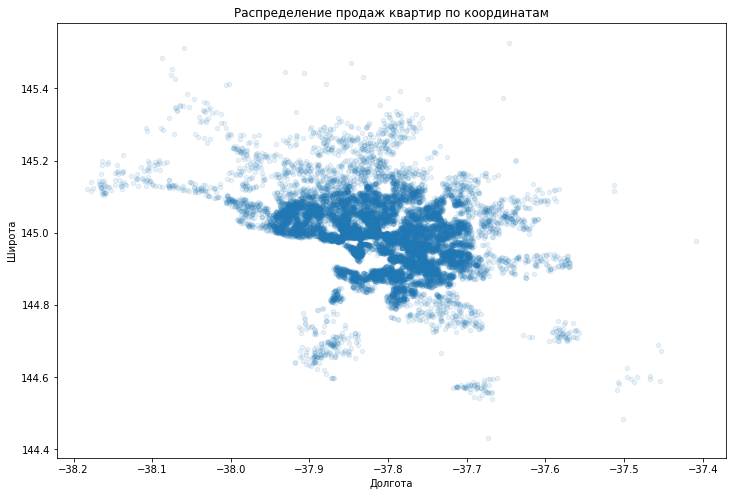

In [18]:
df.plot(kind='scatter', x='lattitude', y='longtitude', alpha=0.1, figsize=(12,8))
plt.title('Распределение продаж квартир по координатам')
plt.xlabel("Долгота")
plt.ylabel("Широта")
plt.show()

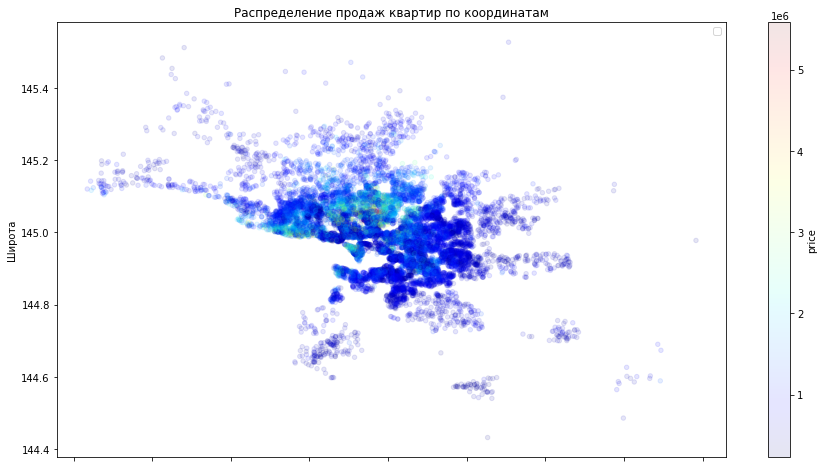

In [19]:
df.plot(kind='scatter', x='lattitude', y='longtitude', alpha=0.1, figsize=(15,8),
       c='price', cmap=plt.get_cmap('jet'), colorbar=True)
plt.legend()
plt.title('Распределение продаж квартир по координатам')
plt.xlabel("Долгота")
plt.ylabel("Широта")
plt.show()

На графике, видно,  что цена квартир распространены следющим образом:

- справо мы имеем жилье в ценовом диапозоне до миллиона евро (синие точки);
- в центре горрода цена кваритры возрастает, цвет точек - морской волны;
- на окраинах грода цена квартиры расположены в одном ценовом диапозоне;

Нанесем координты на карту и выделим квартиры в разным цветом соответсвующие разному ценовому диапозону.

- если цена квартиры лежит в диапозоне 227 000 до 635 000 - зеленый круг
- если цена квартиры лежит в диапозоне 635 000 до 880 000 - желтый круг
- если цена квартиры лежит в диапозоне 880 000 до 1 301 000 - желтый круг
- все что дороже красный.

Цвета зависят от кваритля.

In [20]:
def color_change(price):
    if (227000 <= price < 635000):
        return('green')
    elif(635000 <= price < 880000):
        return('orange')
    elif(880000 <= price < 1301000):
        return('blue')
    else:
        return('red')
    
map = folium.Map(location=[-38.00,144.63000], zoom_start = 10, tiles='CartoDB dark_matter')
lat = df['lattitude'].dropna()
lon = df['longtitude'].dropna()
price = df['price'].dropna()

for lat, lon, price in zip(lat, lon, price):
    folium.CircleMarker(location=[lat, lon], radius = 2, popup=str(price)+"m", 
                        fill_color=color_change(price), color=color_change(price), fill_opacity = 0.9).add_to(map)
    
map

Посмотрим как признаки коррелируют между собой.

In [21]:
corr_matrix = df.corr()
corr_matrix['price'].sort_values(ascending=False)

price            1.000000
rooms            0.499639
bedroom2         0.477260
bathroom         0.463648
car              0.238572
longtitude       0.198808
postcode         0.097487
buildingarea     0.094909
landsize         0.037681
id              -0.004071
propertycount   -0.053093
distance        -0.172521
lattitude       -0.206103
yearbuilt       -0.326959
Name: price, dtype: float64

Цена квартиры очень сильно коррелирует с колличеством комнат, спален, ванн. Учтем это при подготовке к моделированию. 

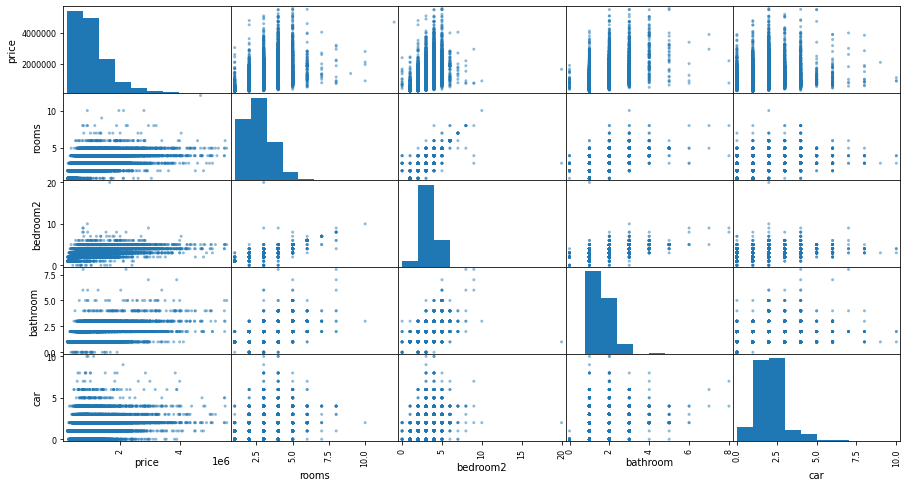

In [22]:
atributes = ['price', 'rooms', 'bedroom2', 'bathroom', 'car']
pd.plotting.scatter_matrix(df[atributes], figsize=(15,8))
plt.show()

Можно увидеть зависимость колличества спален от колличества комнат,колличество ванн от колиичества спален.

Самым многообещающим aтрибутом для прогнозирования средней стоимости дома является колличество комнат, рассморим более подробно.

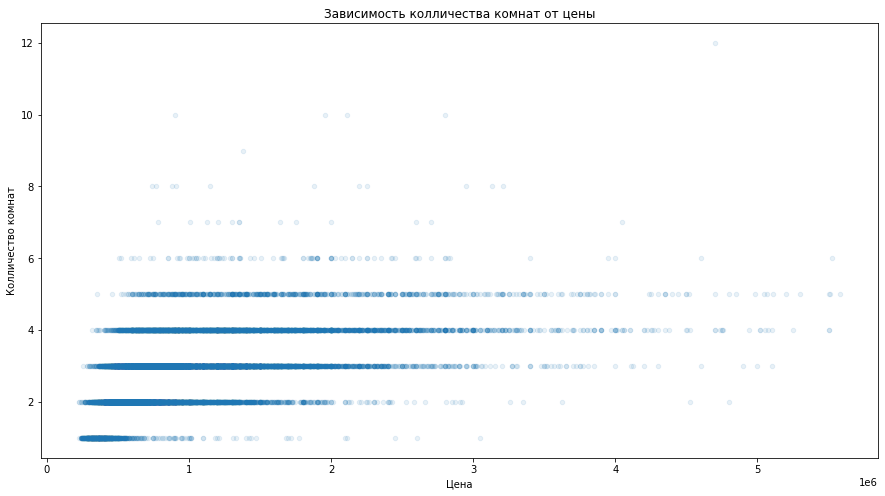

In [23]:
df.plot(kind='scatter', x='price', y='rooms', alpha=0.1, figsize=(15,8))
plt.title('Зависимость колличества комнат от цены')
plt.xlabel("Цена")
plt.ylabel("Колличество комнат")
plt.show()

По графику можно оценить зависимость.

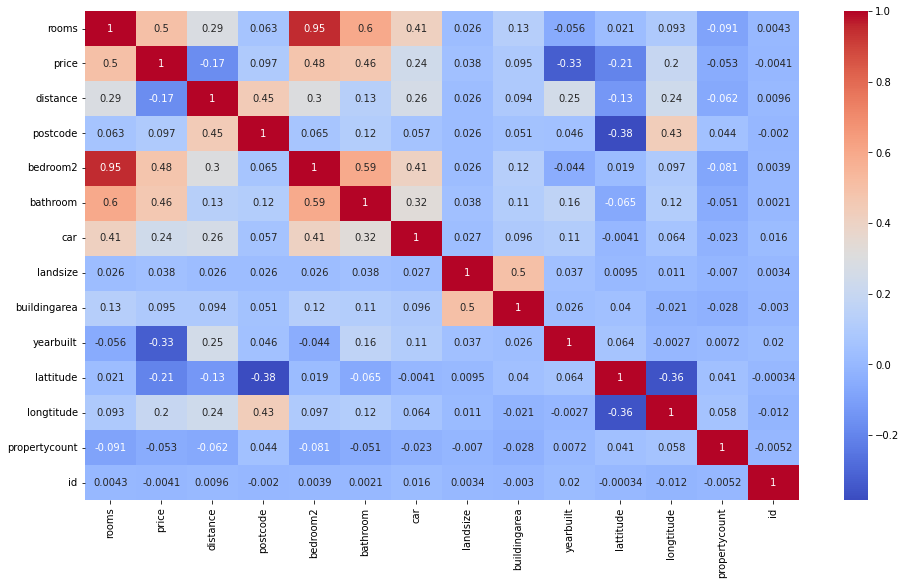

In [24]:
plt.figure(figsize=(16,9))
sns.heatmap(df.corr(),annot=True,cmap="coolwarm")
plt.show()

Посмторим как метод phik увидит зависимости.

In [25]:
phik_overview = df.phik_matrix()
phik_overview['price'].round(2).sort_values(ascending=False)

interval columns not set, guessing: ['rooms', 'price', 'distance', 'postcode', 'bedroom2', 'bathroom', 'car', 'landsize', 'buildingarea', 'yearbuilt', 'lattitude', 'longtitude', 'propertycount', 'id']


price            1.00
address          0.91
suburb           0.61
rooms            0.55
councilarea      0.51
type             0.50
sellerg          0.48
yearbuilt        0.44
bathroom         0.40
car              0.38
lattitude        0.37
bedroom2         0.35
longtitude       0.35
regionname       0.32
postcode         0.28
propertycount    0.26
distance         0.23
method           0.17
date             0.14
landsize         0.05
id               0.03
buildingarea     0.00
Name: price, dtype: float64

Метод phik нашел следующую взаимосвязь, цена квартиры очень завсист от адреса, находится ли дом в пригороде или нет, колличество комнат.

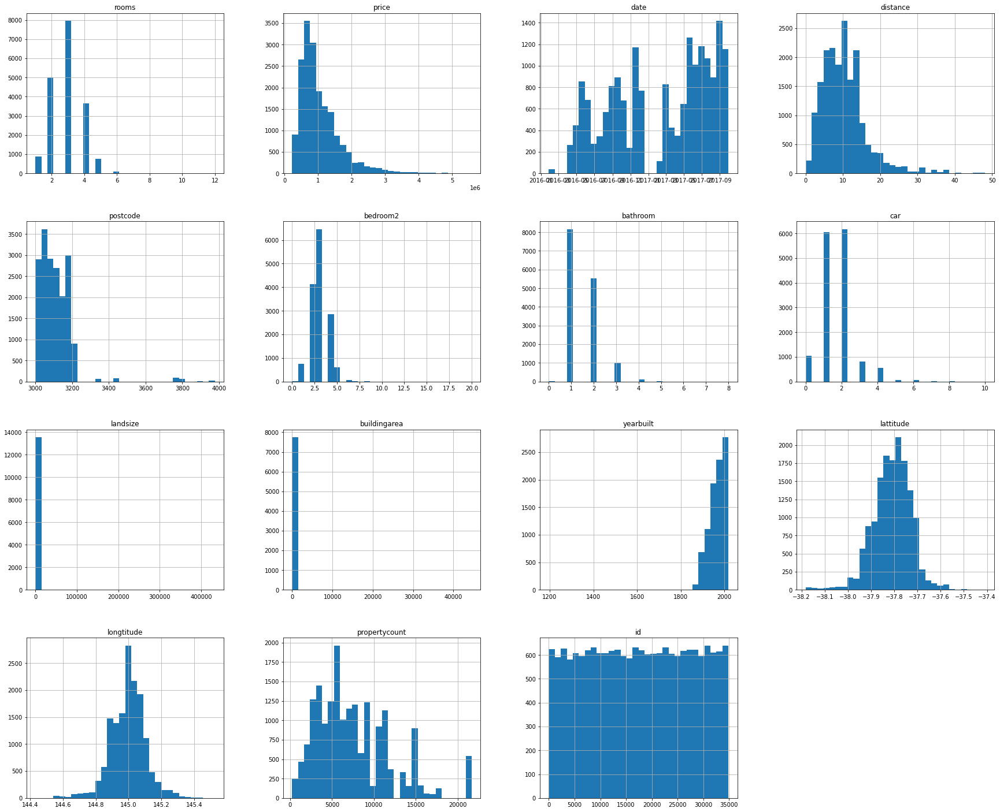

In [26]:
df.hist(figsize = (30, 25), bins = 30, legend = False)
plt.show()

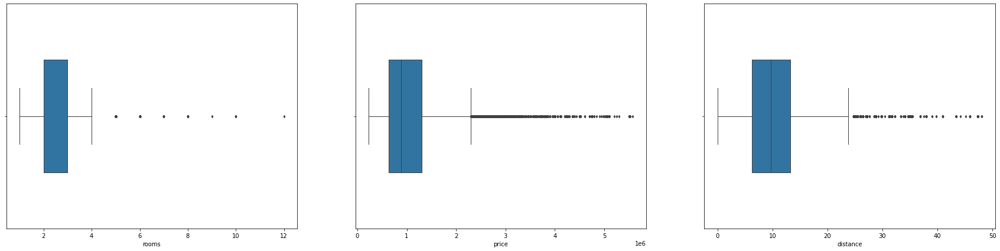

In [27]:
fig, axes = plt.subplots(1, 3, figsize = (30, 7))

sns.boxplot(ax = axes[0], x = "rooms", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[1], x = "price", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[2], x = "distance", data = df, width = 0.5, fliersize = 3, linewidth = 1);

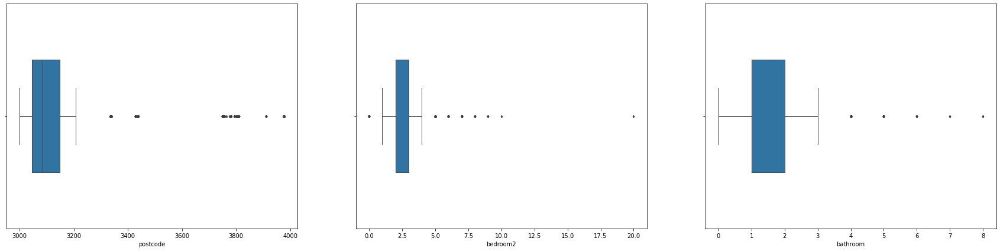

In [28]:
fig, axes = plt.subplots(1, 3, figsize = (30, 7))

sns.boxplot(ax = axes[0], x = "postcode", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[1], x = "bedroom2", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[2], x = "bathroom", data = df, width = 0.5, fliersize = 3, linewidth = 1);

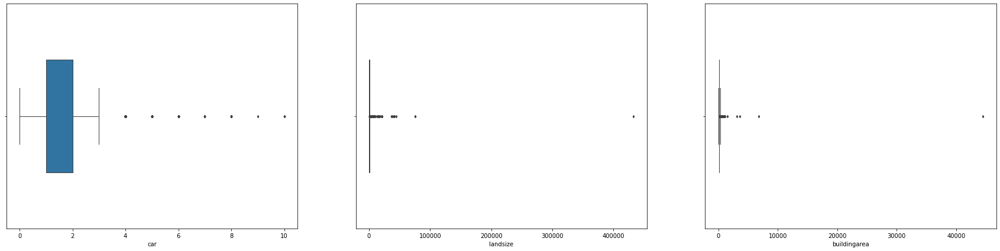

In [29]:
fig, axes = plt.subplots(1, 3, figsize = (30, 7))

sns.boxplot(ax = axes[0], x = "car", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[1], x = "landsize", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[2], x = "buildingarea", data = df, width = 0.5, fliersize = 3, linewidth = 1);

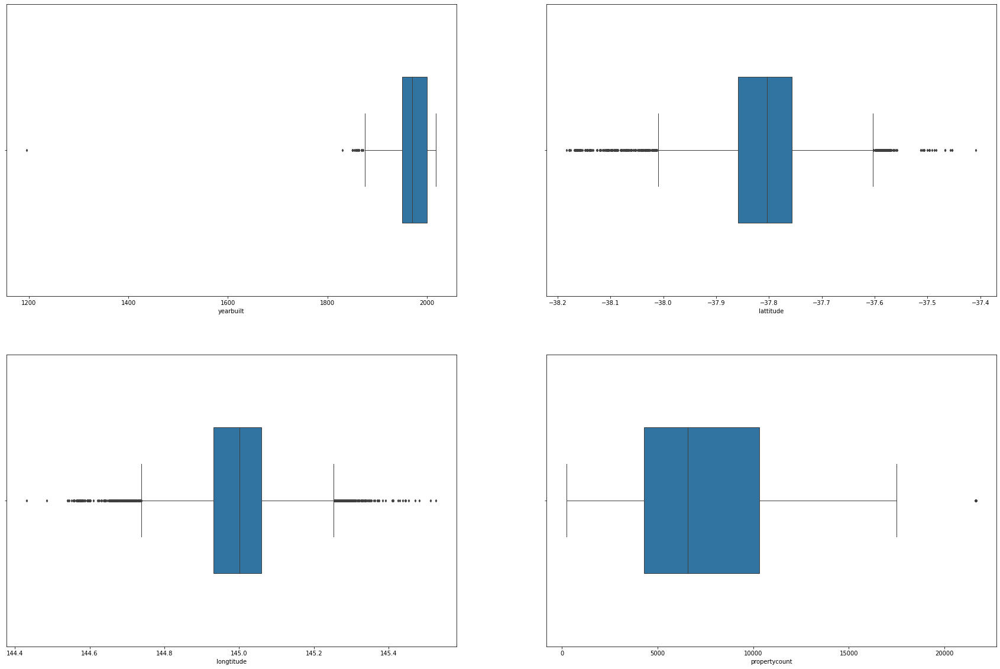

In [30]:
fig, axes = plt.subplots(2, 2, figsize = (30, 20))
axes = axes.flatten()

sns.boxplot(ax = axes[0], x = "yearbuilt", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[1], x = "lattitude", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[2], x = "longtitude", data = df, width = 0.5, fliersize = 3, linewidth = 1);
sns.boxplot(ax = axes[3], x = "propertycount", data = df, width = 0.5, fliersize = 3, linewidth = 1);

<a id="6"></a>

## <b>6 <span style='color:#422e13'>|</span> ПРЕДВАРИТЕЛЬНАЯ ОБРАБОТКА НАБОРА ДАННЫХ </b>

In [31]:
df.isna().mean().sort_values(ascending=False)

buildingarea     0.578185
yearbuilt        0.513199
landsize         0.260926
car              0.194579
bathroom         0.188864
bedroom2         0.188755
longtitude       0.181353
lattitude        0.181353
propertycount    0.000054
regionname       0.000054
councilarea      0.000054
suburb           0.000000
address          0.000000
postcode         0.000000
distance         0.000000
date             0.000000
sellerg          0.000000
method           0.000000
price            0.000000
type             0.000000
rooms            0.000000
id               0.000000
dtype: float64

Больше всего пропущенных значений в buildingarea, yearbuilt, landsize.

---

Общая площадь

Оценим зависимость жилой площади от общей площади недвижимости с помощью линейной регрессии.

Минимизируем квадратичную функцию ошибки:

$$error(w_0, w_1) = \sum_{i=1}^n {(y_i - (w_0 + w_1 * x_i))}^2 $$
Здесь $n$ – число наблюдений в наборе данных *'buildingarea_notna'*, $y_i$ и $x_i$ – общая площадь и размер прилегающей земли $i$-ого объекта недвижимости в наборе данных.

<Figure size 1152x648 with 0 Axes>

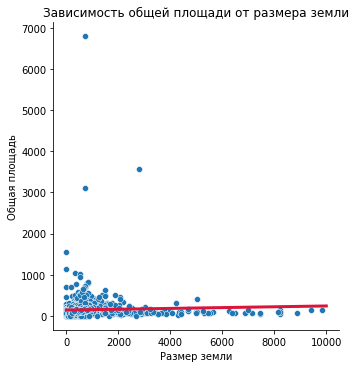

In [32]:
from scipy.optimize import minimize

# сначала очистим данные от пропущенных значений
df_copy = df[df['buildingarea'] < 10000]
buildingarea_notna = df_copy[(df_copy['buildingarea'].notna()) & (df_copy['landsize'].notna())].reset_index(drop=True)

# зададим квадратичную функцию ошибки, зависящую от вектора параметров
def error_function(w):
    sum = 0
    for i in range(len(buildingarea_notna)):
        sum += (buildingarea_notna.loc[i, 'buildingarea'] - (w[0] + w[1] * buildingarea_notna.loc[i, 'landsize'])) ** 2
    return sum

# решим задачу минимизации заданной функции с некоторым начальным приближением
result = minimize(error_function, np.array([0, 0]))

# зададим линейную функцию, отображающую наше решение
def linear_function(w0, w1, x):
    return (w0 + w1 * x)

# Изобразим решение на графике
plt.figure(figsize=(16,9))
sns.relplot(x='landsize', y='buildingarea', data=df[(df['buildingarea'] < 10000) & (df['landsize'] < 10000)])

landsize = np.linspace(0, 10000)
line = plt.plot(landsize, linear_function(result.x[0], result.x[1], landsize), color='crimson', linewidth=3)
plt.title('Зависимость общей площади от размера земли')
plt.xlabel('Размер земли')
plt.ylabel('Общая площадь')
plt.show()

In [33]:
# заменим все пропущенные значения на основе оцененной зависимости
df.loc[df['buildingarea'].isna(), 'buildingarea'] = result.x[0] + result.x[1] * df.loc[df['buildingarea'].isna(), 'landsize']
df_test.loc[df_test['buildingarea'].isna(), 'buildingarea'] = result.x[0] + result.x[1] * df_test.loc[df_test['buildingarea'].isna(), 'landsize']
# проверим, все ли пропущенные значения мы обработали
print(df.isna().sum().sort_values(ascending=False))
print('___________________________')
print(df_test.isna().sum().sort_values(ascending=False))

yearbuilt        9429
landsize         4794
buildingarea     4169
car              3575
bathroom         3470
bedroom2         3468
longtitude       3332
lattitude        3332
propertycount       1
regionname          1
councilarea         1
suburb              0
address             0
postcode            0
distance            0
date                0
sellerg             0
method              0
price               0
type                0
rooms               0
id                  0
dtype: int64
___________________________
yearbuilt        5706
landsize         4453
buildingarea     3806
car              3236
bathroom         2964
bedroom2         2960
longtitude       2910
lattitude        2910
propertycount       2
regionname          2
councilarea         2
distance            1
postcode            1
suburb              0
address             0
date                0
sellerg             0
method              0
type                0
rooms               0
id                  0
dtype: int64


Остальные пропущеные значения заменим медианным

In [34]:
categorical_columns = [c for c in df.columns if df[c].dtype.name == 'object']
numerical_columns   = [c for c in df.columns if df[c].dtype.name != 'object' and df[c].dtype.name != 'datetime64[ns]' and c != 'price']

In [35]:
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

In [36]:
df[numerical_columns] = imputer.fit_transform(df[numerical_columns])
df_test[numerical_columns] = imputer.transform(df_test[numerical_columns])

In [37]:
df['councilarea'] = df['councilarea'].transform(lambda x: x.fillna('no_info'))
df['regionname'] = df['regionname'].transform(lambda x: x.fillna('no_info'))

df_test['councilarea'] = df_test['councilarea'].transform(lambda x: x.fillna('no_info'))
df_test['regionname'] = df_test['regionname'].transform(lambda x: x.fillna('no_info'))

<a id="7"></a>

## <b>7 <span style='color:#422e13'>|</span> МОДЕЛИРОВАНИЕ </b>

<a id="7.1"></a>

#### <b>7.1 <span style='color:#422e13'>|</span> Создание дополнительных фичей</b>

Создадим дополнительные признаки:
 - средную площадь комнаты;
 - дистанцую на расстояние.

In [38]:
train, test =  train_test_split(df,test_size=0.2,random_state=42)

In [39]:
train['mid_area_rooms'] = train['buildingarea'] / train['rooms']
train['distance_share_rooms'] = train['distance'] / train['rooms']

In [40]:
target  = ['price']
features = list(df.drop(columns = ['price']).columns)
cat_features = list(df.select_dtypes(include = ['object']).columns)

<a id="7.2"></a>

#### <b>7.2 <span style='color:#422e13'>|</span> Catboost</b>

In [41]:
train_data = Pool(data=train[features], label=train[target], cat_features=cat_features)

In [42]:
def objective(trial):
    global train_data

    param = {
        #'task_type':trial.suggest_categorical("task_type", 'CPU'),
        #'devices':trial.suggest_int('devices', 0, 1),
        "n_estimators": trial.suggest_int("n_estimators", 1000, 4000, 200),
        "max_depth": trial.suggest_int("max_depth", 2, 10, 1),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1, 8),
        "random_strength": trial.suggest_float("random_strength", 0.9, 1.4),
        "learning_rate": trial.suggest_float("eta", 1e-2, 1e-1, log=True),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 3, 5),
        "grow_policy": trial.suggest_categorical("grow_policy", ["Lossguide"]),
        #"boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "eval_metric": trial.suggest_categorical("eval_metric", ["MAPE"]),
        "loss_function": trial.suggest_categorical("loss_function", ["MAE"]),
        "silent": trial.suggest_categorical("silent", [True]),
        #'logging_level': trial.suggest_categorical('logging_level', ['Silent']),
    }
    
    scores = cv(train_data, param, fold_count=5)

    return scores['test-MAPE-mean'].values[-1]

In [43]:
%%time
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=5, show_progress_bar = True)

  0%|          | 0/5 [00:00<?, ?it/s]

Training on fold [0/5]

bestTest = 0.1560157864
bestIteration = 1599

Training on fold [1/5]

bestTest = 0.1580947923
bestIteration = 1599

Training on fold [2/5]

bestTest = 0.1530311691
bestIteration = 1599

Training on fold [3/5]

bestTest = 0.1584308455
bestIteration = 1599

Training on fold [4/5]

bestTest = 0.1553539132
bestIteration = 1599

Training on fold [0/5]

bestTest = 0.1423713257
bestIteration = 2665

Training on fold [1/5]


/opt/conda/lib/python3.7/site-packages/phik/bivariate.py:243: UserWarning: Many cells: 5524160. Are interval variables set correctly?
  len(corr0)
/opt/conda/lib/python3.7/site-packages/phik/bivariate.py:243: UserWarning: Many cells: 5958848. Are interval variables set correctly?
  len(corr0)



bestTest = 0.1427760197
bestIteration = 3544

Training on fold [2/5]

bestTest = 0.140127668
bestIteration = 3541

Training on fold [3/5]

bestTest = 0.142810839
bestIteration = 2887

Training on fold [4/5]

bestTest = 0.1417025016
bestIteration = 3464

Training on fold [0/5]

bestTest = 0.1502916133
bestIteration = 2199

Training on fold [1/5]

bestTest = 0.1512264849
bestIteration = 2191

Training on fold [2/5]

bestTest = 0.1466949781
bestIteration = 2198

Training on fold [3/5]

bestTest = 0.1518182796
bestIteration = 2199

Training on fold [4/5]

bestTest = 0.1486016948
bestIteration = 2178

Training on fold [0/5]

bestTest = 0.1453702018
bestIteration = 3103

Training on fold [1/5]

bestTest = 0.1450407557
bestIteration = 2753

Training on fold [2/5]

bestTest = 0.1415069492
bestIteration = 3173

Training on fold [3/5]

bestTest = 0.1436280946
bestIteration = 3088

Training on fold [4/5]

bestTest = 0.142071478
bestIteration = 2623

Training on fold [0/5]

bestTest = 0.143917800

In [44]:
study.best_params

{'n_estimators': 1600,
 'max_depth': 3,
 'subsample': 0.9194304361032978,
 'l2_leaf_reg': 2.4566388377137347,
 'random_strength': 1.0327308726862576,
 'eta': 0.014186678782365977,
 'min_data_in_leaf': 4,
 'grow_policy': 'Lossguide',
 'eval_metric': 'MAPE',
 'loss_function': 'MAE',
 'silent': True}

In [45]:
model_catboost = CatBoostRegressor(**study.best_params)

In [46]:
model_catboost.fit(train_data)

In [47]:
joblib.dump(model_catboost, "catboost.pkl", compress=9)

['catboost.pkl']

In [48]:
model_catboost_plk = joblib.load("catboost.pkl")

In [49]:
test['predict'] = model_catboost_plk.predict(test[features])

In [50]:
def error(y_true,y_pred):
  print(mean_absolute_error(y_true,y_pred))
  print(mean_absolute_percentage_error(y_true,y_pred))

In [51]:
error(test['price'],test['predict'])

181212.52782304864
0.15996033506372512


<a id="7.3"></a>

#### <b>7.7 <span style='color:#422e13'>|</span> Keras</b>

Попробуем обучить модель с помощью нейросети. Тут я импортирую все библиотеки заново, так как переключил ядро на GPU.

In [52]:
from sklearn.preprocessing import MinMaxScaler, OrdinalEncoder, OneHotEncoder

from keras.models import Sequential
from keras.layers import Dense

Разделим еще раз набор данных

In [53]:
train, test =  train_test_split(df,test_size=0.2,random_state=42)

In [54]:
train['mid_area_rooms'] = train['buildingarea'] / train['rooms']
train['distance_share_rooms'] = train['distance'] / train['rooms']
test['mid_area_rooms'] = test['buildingarea'] / test['rooms']
test['distance_share_rooms'] = test['distance'] / test['rooms']

In [55]:
scaler = MinMaxScaler()
scaler.fit(df[numerical_columns])
train[numerical_columns] = scaler.transform(train[numerical_columns])
test[numerical_columns] = scaler.transform(test[numerical_columns])

In [56]:
enc = preprocessing.OrdinalEncoder()
enc.fit(df[categorical_columns])
train[categorical_columns] = enc.transform(train[categorical_columns])
test[categorical_columns] = enc.transform(test[categorical_columns])

In [57]:
features = ['suburb',
 'address',
 'rooms',
 'type',
 'method',
 'sellerg',
 'distance',
 'postcode',
 'bedroom2',
 'bathroom',
 'car',
 'landsize',
 'buildingarea',
 'yearbuilt',
 'councilarea',
 'lattitude',
 'longtitude',
 'regionname',
 'propertycount',
 'id',
 'mid_area_rooms', 
 'distance_share_rooms'
]

Создаем нейронную сеть

Выходной слой с одним линейным нейроном - для задачи регрессии функция активации - RELU.

Хорошая статья на habar

https://habr.com/ru/post/485890/

In [58]:
#создание сети
model = Sequential()
model.add(Dense(512, activation='relu',
                          input_shape=(train[features].shape[1],)))
model.add(Dense(1024, activation='relu'))
model.add(Dense(1024, activation='relu'))
model.add(Dense(1024, activation='relu'))
model.add(Dense(1024, activation='relu'))
model.add(Dense(512, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1))
#компелирование сети. Функция ошибки - среднеквадратичное отклонение. Метрика - среднее абсолютное отклонение.
model.compile(optimizer='nadam', loss='mse', metrics=['mae'])

2023-01-07 18:05:14.258115: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-07 18:05:14.473426: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-07 18:05:14.474281: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-07 18:05:14.475372: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [59]:
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 512)               11776     
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              525312    
_________________________________________________________________
dense_2 (Dense)              (None, 1024)              1049600   
_________________________________________________________________
dense_3 (Dense)              (None, 1024)              1049600   
_________________________________________________________________
dense_4 (Dense)              (None, 1024)              1049600   
_________________________________________________________________
dense_5 (Dense)              (None, 512)               524800    
_________________________________________________________________
dense_6 (Dense)              (None, 128)               6

Обучаем нейронную сеть

In [60]:
history = model.fit(train[features], 
                    train[target], 
                    epochs=300, 
                    validation_split=0.1, 
                    verbose=2)

2023-01-07 18:05:20.488344: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/300
414/414 - 5s - loss: 592289464320.0000 - mae: 555839.5625 - val_loss: 490666655744.0000 - val_mae: 500613.3125
Epoch 2/300
414/414 - 2s - loss: 590896955392.0000 - mae: 537139.0000 - val_loss: 519514226688.0000 - val_mae: 512591.5000
Epoch 3/300
414/414 - 2s - loss: 535614259200.0000 - mae: 519508.0625 - val_loss: 566608789504.0000 - val_mae: 512090.5000
Epoch 4/300
414/414 - 2s - loss: 513458143232.0000 - mae: 508120.5625 - val_loss: 449446903808.0000 - val_mae: 475089.0312
Epoch 5/300
414/414 - 2s - loss: 477756456960.0000 - mae: 489153.5625 - val_loss: 446005739520.0000 - val_mae: 506138.8125
Epoch 6/300
414/414 - 2s - loss: 435144982528.0000 - mae: 469224.3750 - val_loss: 400111140864.0000 - val_mae: 442550.5938
Epoch 7/300
414/414 - 2s - loss: 422534283264.0000 - mae: 459183.8125 - val_loss: 675071459328.0000 - val_mae: 682112.1875
Epoch 8/300
414/414 - 2s - loss: 394441555968.0000 - mae: 445940.6875 - val_loss: 335940714496.0000 - val_mae: 425888.0938
Epoch 9/300
414/

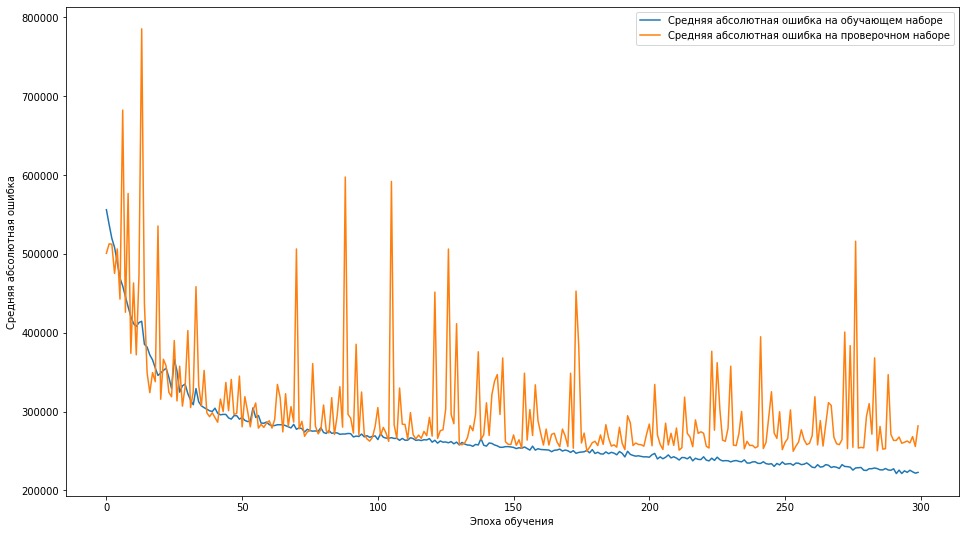

In [61]:
plt.figure(figsize=(16,9))
plt.plot(history.history['mae'], 
         label='Средняя абсолютная ошибка на обучающем наборе')
plt.plot(history.history['val_mae'], 
         label='Средняя абсолютная ошибка на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Средняя абсолютная ошибка')
plt.legend()
plt.show()

In [62]:
test['predict'] = model.predict(test[features])

In [63]:
def error(y_true,y_pred):
    print(mean_absolute_error(y_true,y_pred))
    print(mean_absolute_percentage_error(y_true,y_pred))

In [64]:
#test=test.dropna()

In [65]:
error(test['price'],test['predict'])

276761.02783163264
0.29117581785971425


<a id="8"></a>

## <b>8 <span style='color:#422e13'>|</span> Выводы </b>

<div style="border-radius: 8px; border : black solid; background-color: #1FAEE9; font-size:100%; text-align: left">

<h3 style='; border:0; border-radius: 8px; font-weight: bold; color:black'><center> В ходе работы выполнено: </center></h3 >

● Изучено задание, проведен первичный анализ данных.

    Данные содержат 18373 перменных, 21 солбец. Целевой показатель - цена недвижимости (price). Данные представлены c 2016-01-28 по 2017-09-30. 

● Проведена предобработка данных:

    данные проверены на наличие дубликатов и пропущенных значений. Дубликатов нет. Были обнаружены пропущенные значения в таблице. Самое большое из них - общая площадь. Заменили ее с помощью линейной регрессии. В остальных четких взаимосвязей не нашли, поэтому заменили медианными значениями. 

● Проведен исследовательский анализ данных:

    с помощью метода phik выявлены взаимосвязи. Добавлены новые признаки.

● Проведено моделирование:

    построена модель Catboost. При построении модели подобраны с помощью optune оптимальные параметры.

    построена модель Keras.

    лучшая модель по показатель MAPE - Catboost. MAPE равен 0.144.

● Проведено тестирование модели.

------

Выбрали лучшую модель Catboost делаем предикт на данных для submission

In [66]:
target  = ['price']
features = list(df.drop(columns = ['price']).columns)
cat_features = list(df.select_dtypes(include = ['object']).columns)

In [67]:
test_data_pred = Pool(data=df_test[features],
                  cat_features=cat_features
                 )

In [68]:
df_test['Price'] = model_catboost_plk.predict(test_data_pred)

In [69]:
df_test['id'] = df_test['id'].astype('int32')

In [70]:
df_test[['id', 'Price']].to_csv('predict.csv', index=False)

In [71]:
df_test[['id', 'Price']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8818 entries, 0 to 8817
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      8818 non-null   int32  
 1   Price   8818 non-null   float64
dtypes: float64(1), int32(1)
memory usage: 103.5 KB
